## Applying Histogram Equalisation

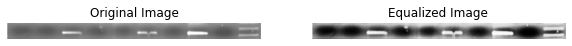

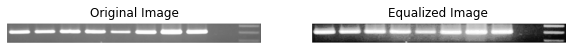

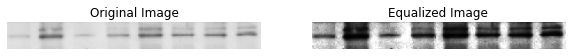

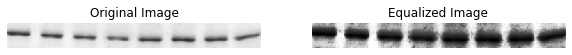

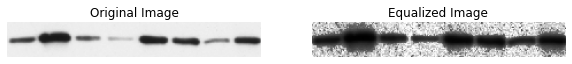

...

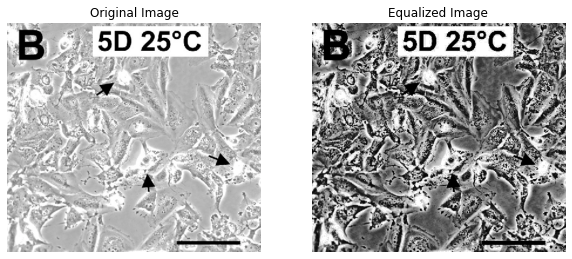

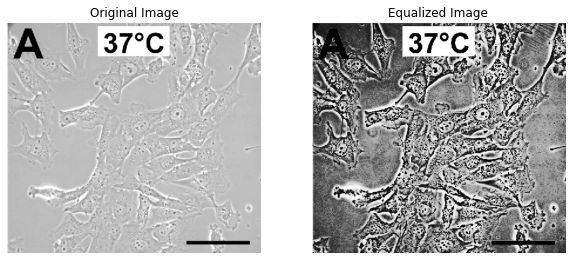

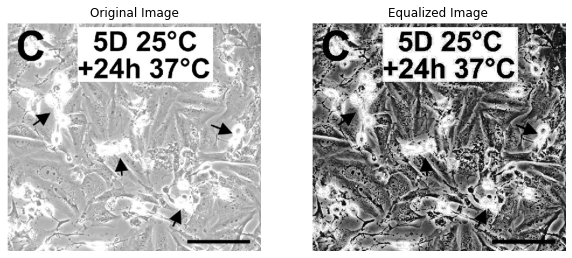

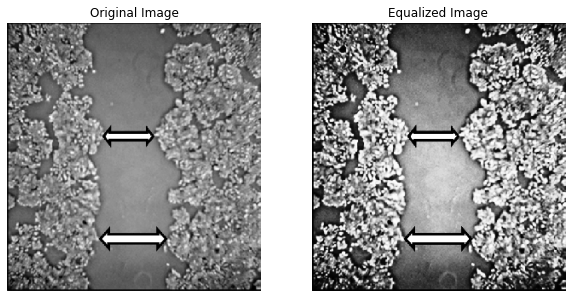

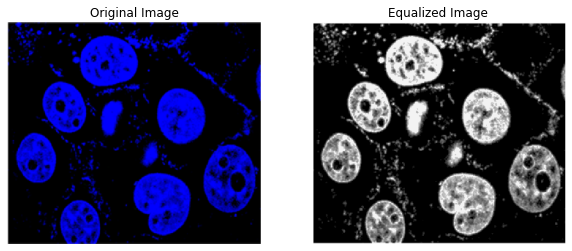

Histogram equalization complete.


In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

# Define the base directory where images are located
base_directory = "New_folder"

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Perform histogram equalization
        equalized_image = cv2.equalizeHist(gray_image)

        # Plot the original and equalized images
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(equalized_image, cmap='gray')
        axes[1].set_title('Equalized Image')
        axes[1].axis('off')
        plt.show()

        # Increment the display count
        display_count += 1

        # Check if 5 images have been displayed for the current class
        if display_count >= 5:
            break

    # Reset the display count for the next class
    display_count = 0

print("Histogram equalization complete.")


## Applying Histogram Equalisation + Denoising

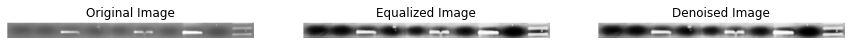

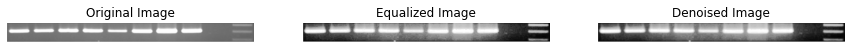

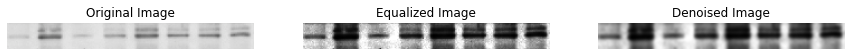

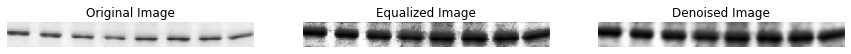

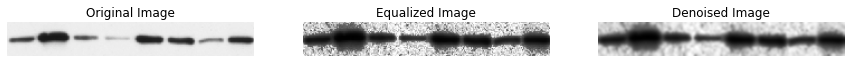

...

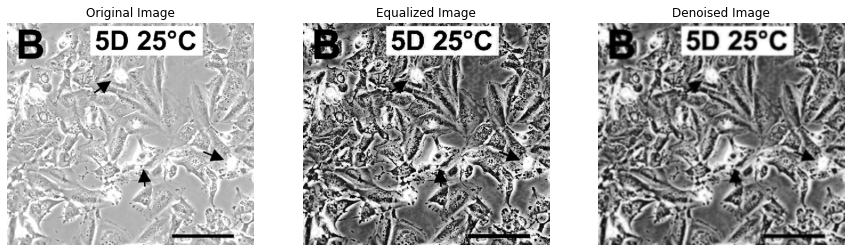

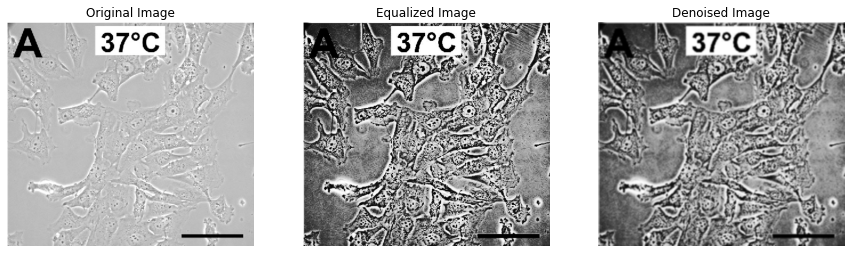

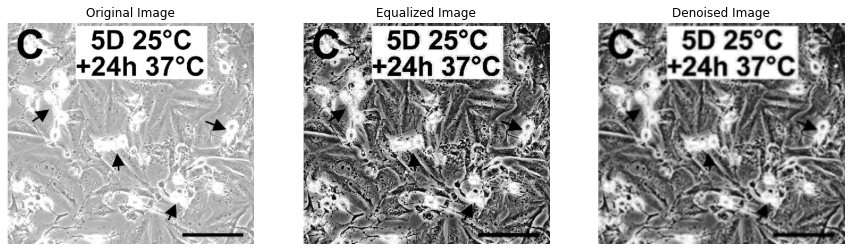

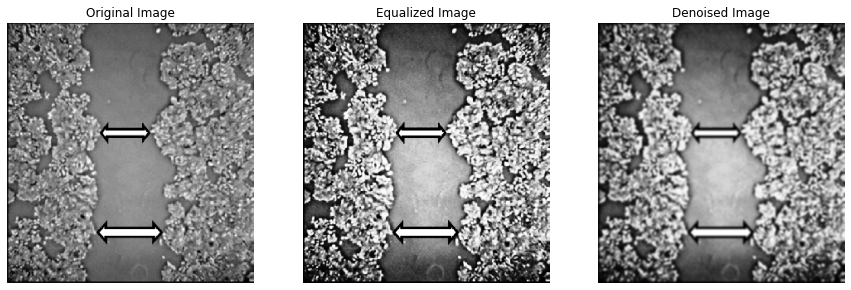

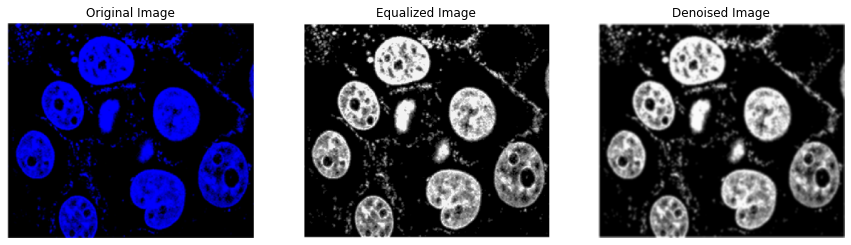

Histogram equalization and denoising complete.


In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

# Define the base directory where images are located
base_directory = "New_folder"

# Define the number of images to display per class
images_per_class = 5

# Define the denoising method
denoising_method = 'gaussian'

# Define the parameters for the denoising filter
gaussian_kernel_size = (5, 5)
gaussian_sigma = 0

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        if display_count >= images_per_class:
            break

        image_path = os.path.join(class_directory, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Perform histogram equalization
        equalized_image = cv2.equalizeHist(gray_image)

        # Apply denoising
        if denoising_method == 'gaussian':
            # Apply Gaussian denoising
            denoised_image = cv2.GaussianBlur(equalized_image, gaussian_kernel_size, gaussian_sigma)
        else:
            raise ValueError("Invalid denoising method. Please choose 'gaussian'.")

        # Plot the original, equalized, and denoised images
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(equalized_image, cmap='gray')
        axes[1].set_title('Equalized Image')
        axes[1].axis('off')
        axes[2].imshow(denoised_image, cmap='gray')
        axes[2].set_title('Denoised Image')
        axes[2].axis('off')
        plt.show()

        # Increment the display count
        display_count += 1

print("Histogram equalization and denoising complete.")


In [ ]:
# denoising (seperately)

In [ ]:
import os

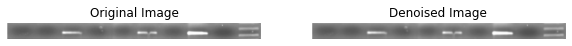

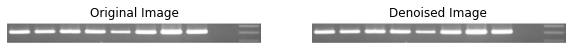

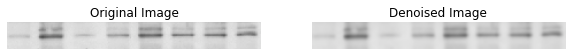

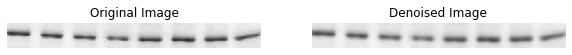

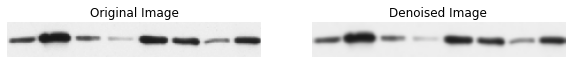

...

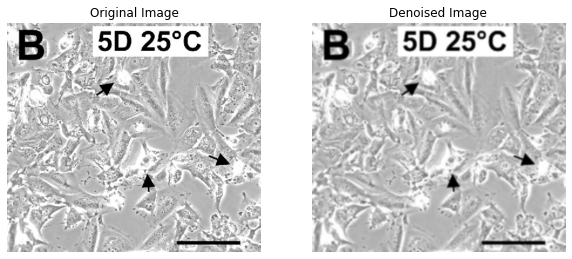

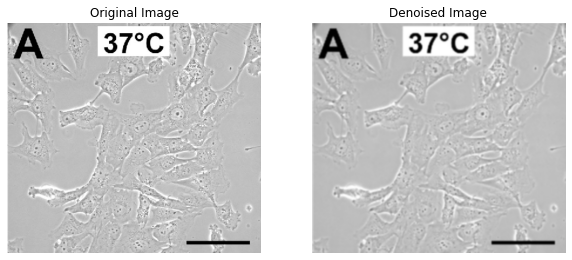

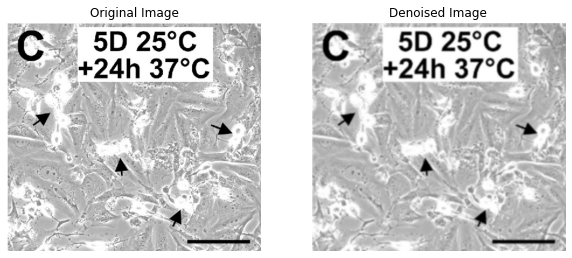

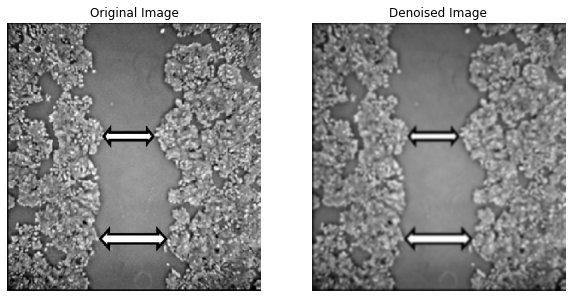

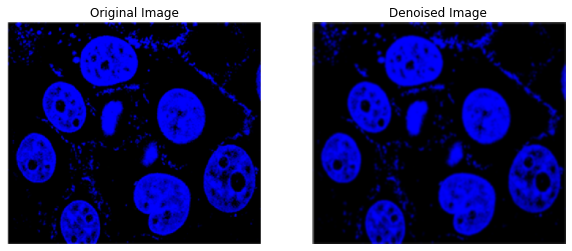

Image denoising complete.


In [ ]:


# Define the denoising method (e.g., 'gaussian' or 'median')
denoising_method = 'gaussian'

# Define the number of images to display per class
images_per_class = 5

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        if display_count >= images_per_class:
            break

        image_path = os.path.join(class_directory, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Apply denoising
        if denoising_method == 'gaussian':
            # Apply Gaussian denoising
            denoised_image = cv2.GaussianBlur(image, (5, 5), 0)

        else:
            raise ValueError("Invalid denoising method. Please choose 'gaussian' or 'median'.")

        # Plot the original and denoised images side by side
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        axes[1].set_title('Denoised Image')
        axes[1].axis('off')
        plt.show()

        # Increment the display count
        display_count += 1

print("Image denoising complete.")


## laplacian and unmasked filtering

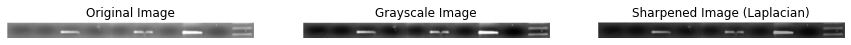

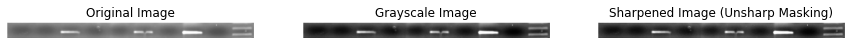

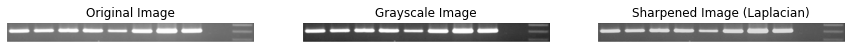

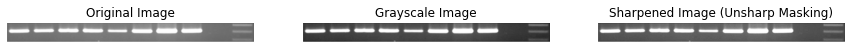

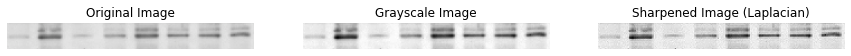

...

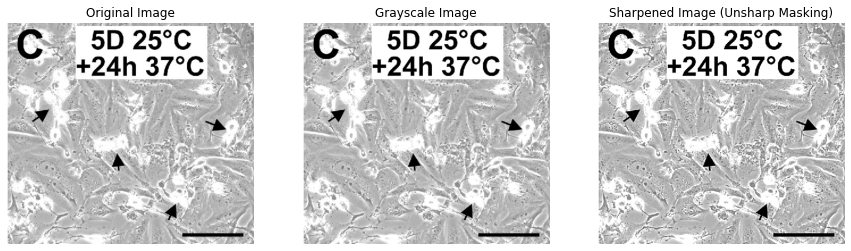

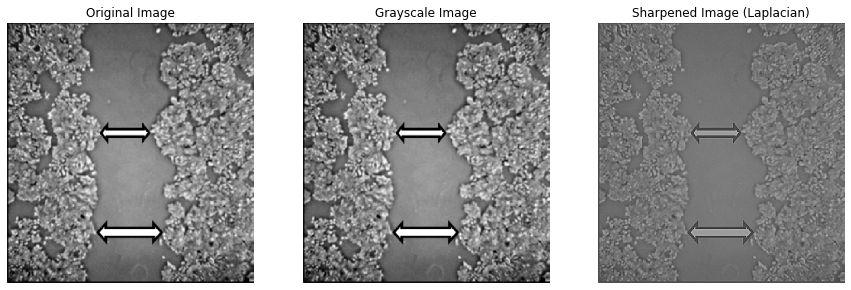

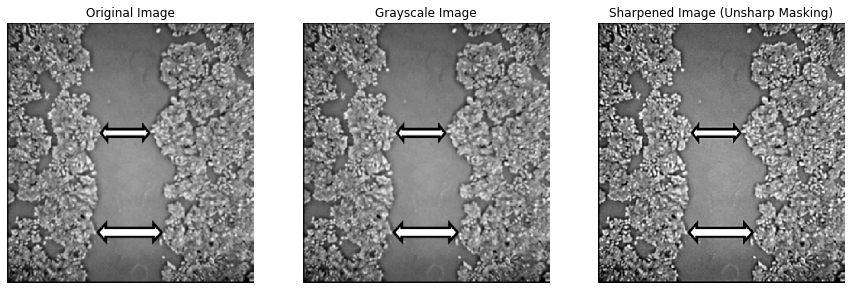

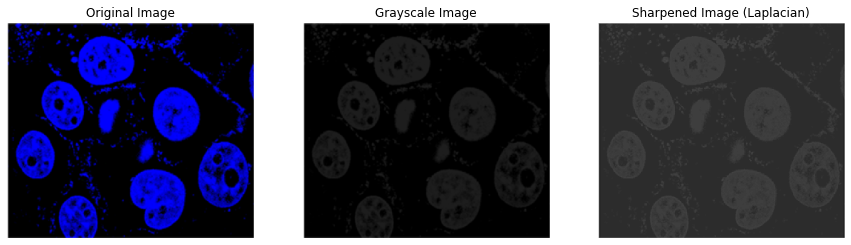

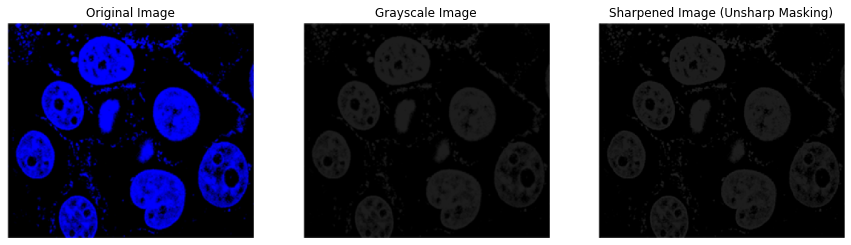

Sharpening complete.


In [ ]:

# Define the number of images to display per class
images_per_class = 5

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        if display_count >= images_per_class:
            break

        image_path = os.path.join(class_directory, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply Laplacian filter for sharpening
        laplacian = cv2.Laplacian(gray_image, cv2.CV_64F)
        sharpened_image = gray_image - 0.5 * laplacian

        # Apply Unsharp masking for sharpening
        gaussian_blur = cv2.GaussianBlur(gray_image, (5, 5), 10)
        unsharp_mask = cv2.addWeighted(gray_image, 1.5, gaussian_blur, -0.5, 0)

        # Plot the original and sharpened images side by side
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(gray_image, cmap='gray')
        axes[1].set_title('Grayscale Image')
        axes[1].axis('off')
        axes[2].imshow(sharpened_image, cmap='gray')
        axes[2].set_title('Sharpened Image (Laplacian)')
        axes[2].axis('off')
        plt.show()

        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(gray_image, cmap='gray')
        axes[1].set_title('Grayscale Image')
        axes[1].axis('off')
        axes[2].imshow(unsharp_mask, cmap='gray')
        axes[2].set_title('Sharpened Image (Unsharp Masking)')
        axes[2].axis('off')
        plt.show()

        # Increment the display count
        display_count += 1

print("Sharpening complete.")


In [ ]:
# i have tried three sharpening
# Laplacian Sharpening: The Laplacian operator is applied to the image to highlight regions of rapid intensity change, such as edges. It accentuates high-frequency components in the image, thereby sharpening it.

# unsharp masking:
# Wavelet Transform: Wavelet-based sharpening techniques decompose the image into different frequency bands and apply sharpening operations selectively to certain bands. This can preserve important details while reducing noise.

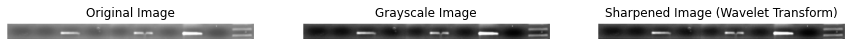

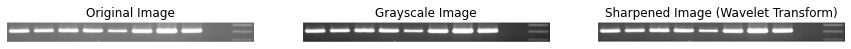

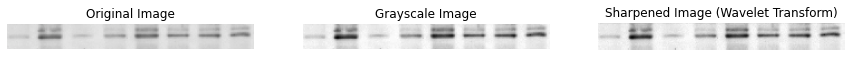

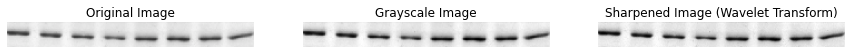

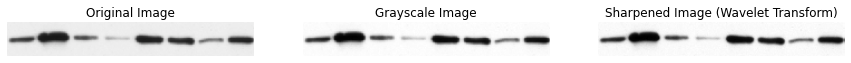

...

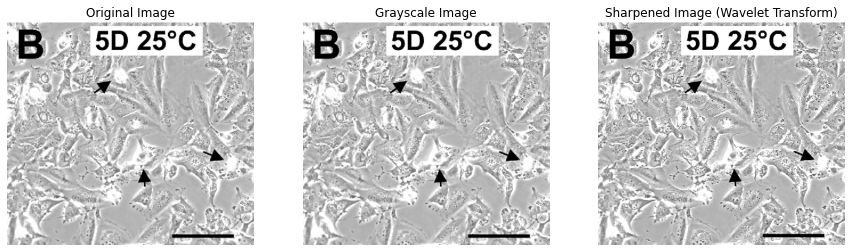

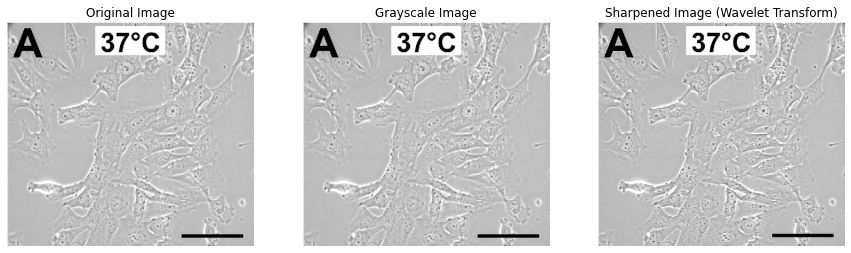

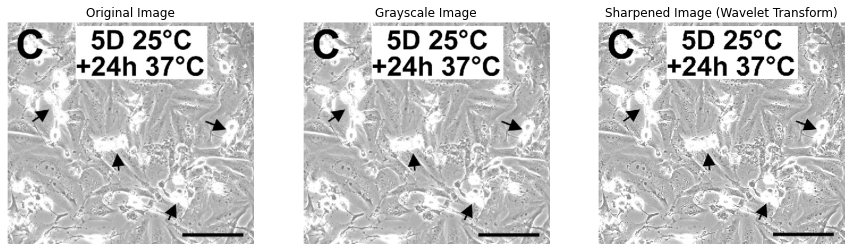

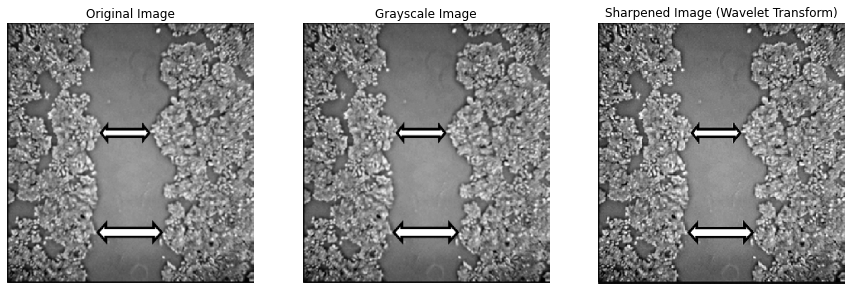

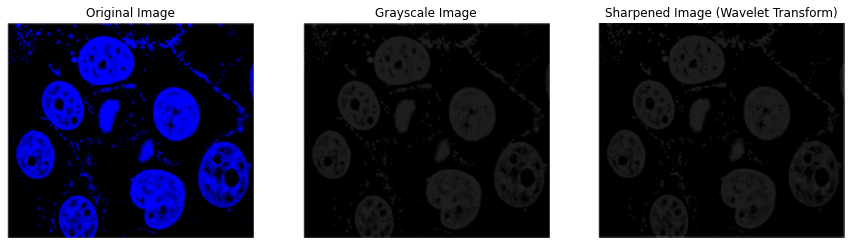

Sharpening complete.


In [ ]:


# Function to apply Wavelet Transform-based sharpening
def wavelet_sharpening(image):
    # Perform Wavelet Transform
    coeffs = pywt.dwt2(image, 'haar')
    cA, (cH, cV, cD) = coeffs
    # Enhance details by amplifying high-frequency components (cH, cV, cD)
    enhanced_coeffs = (cA, (cH * 1.5, cV * 1.5, cD * 1.5))
    # Reconstruct image from enhanced coefficients
    sharpened_image = pywt.idwt2(enhanced_coeffs, 'haar')
    # Clip pixel values to valid range
    sharpened_image = np.clip(sharpened_image, 0, 255).astype(np.uint8)
    return sharpened_image

# Define the base directory where images are located
base_directory = "New_folder"

# Define the number of images to display per class
images_per_class = 5

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        if display_count >= images_per_class:
            break

        image_path = os.path.join(class_directory, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply Wavelet Transform-based sharpening
        sharpened_image = wavelet_sharpening(gray_image)

        # Display the images
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        # Original Image
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')

        # Grayscale Image
        axes[1].imshow(gray_image, cmap='gray')
        axes[1].set_title('Grayscale Image')
        axes[1].axis('off')

        # Sharpened Image (Wavelet Transform)
        axes[2].imshow(sharpened_image, cmap='gray')
        axes[2].set_title('Sharpened Image (Wavelet Transform)')
        axes[2].axis('off')

        plt.show()

        # Increment the display count
        display_count += 1

print("Sharpening complete.")


In [ ]:
# gamma correction as colorful images lost their color after wavelet transform

In [ ]:
#  gamma correction is applied after sharpening the image and before displaying it. This correction helps adjust the brightness and contrast levels of the sharpened image,
# making it more visually appealing and potentially improving the clarity of features, which aids in the interpretation and analysis of medical images.

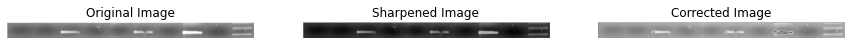

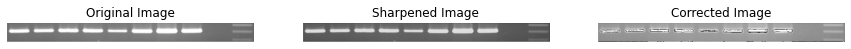

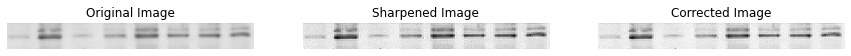

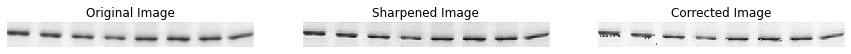

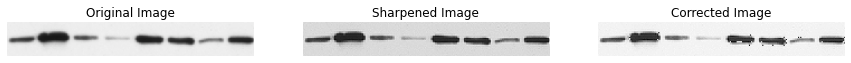

...

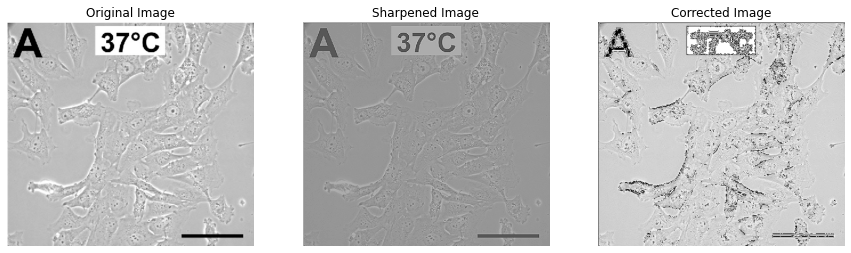

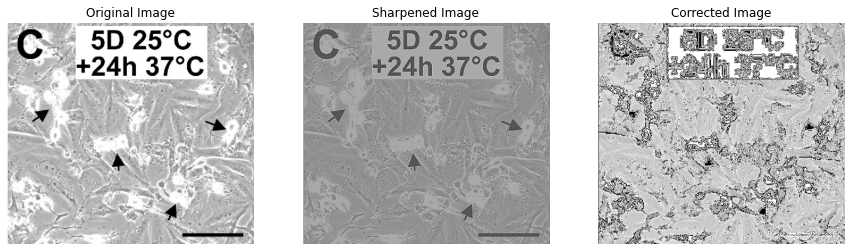

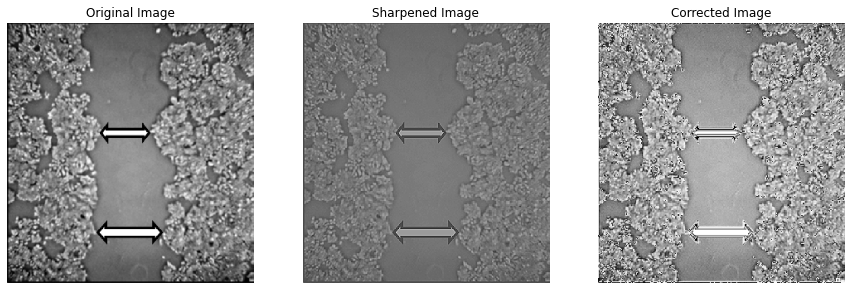

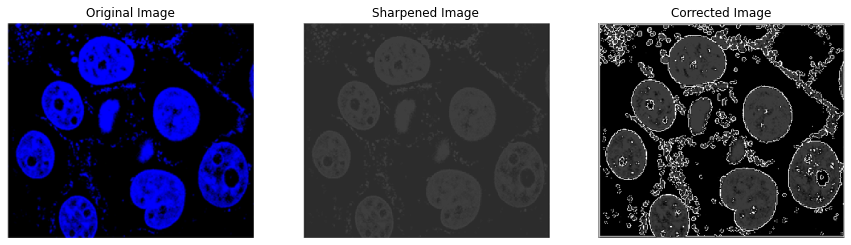

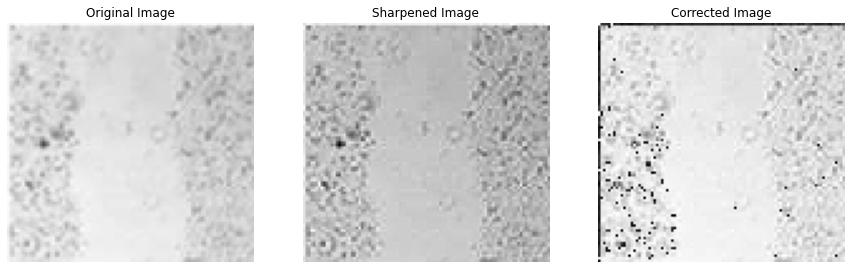

In [ ]:
# Define the gamma value for gamma correction
import os
base_directory = "New_folder"
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
gamma = 1.5

# Define the number of images to display per class
images_per_class = 6

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        # Check if the number of images displayed exceeds the limit
        if display_count >= images_per_class:
            break

        # Read the original image
        original_image_path = os.path.join(class_directory, image_name)
        original_image = cv2.imread(original_image_path)

        # Apply sharpening (add your sharpening code here)
        # For example, Laplacian sharpening
        gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
        laplacian = cv2.Laplacian(gray_image, cv2.CV_64F)
        sharpened_image = gray_image - 0.5 * laplacian

        # Apply gamma correction
        corrected_image = np.clip(cv2.LUT(sharpened_image.astype(np.uint8),
                                           np.array([((i / 255.0) ** (1.0 / gamma)) * 255
                                                     for i in range(256)]).astype(np.uint8)), 0, 255)

        # Display the original, sharpened, and corrected images side by side
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        # Original Image
        axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')

        # Sharpened Image
        axes[1].imshow(sharpened_image, cmap='gray')
        axes[1].set_title('Sharpened Image')
        axes[1].axis('off')

        # Corrected Image
        axes[2].imshow(corrected_image, cmap='gray')
        axes[2].set_title('Corrected Image')
        axes[2].axis('off')

        plt.show()

        # Increment the display count
        display_count += 1

In [ ]:
# gamma corrector is giving very nice result after using laplacian filter

In [ ]:
# there are some images that are corrupted or completely black, we are  computing the average black value of each image and if the value of an incoming image is greater than that average consider it corrupt

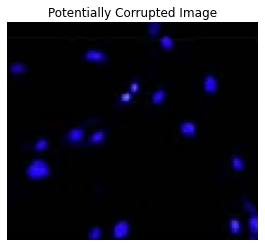

Image removed: New_folder\micro\010033.png


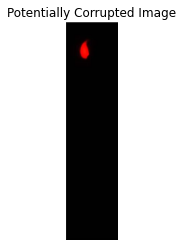

Image removed: New_folder\micro\010108.png


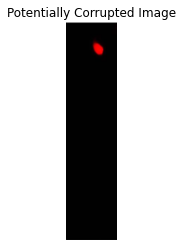

Image removed: New_folder\micro\010113.png


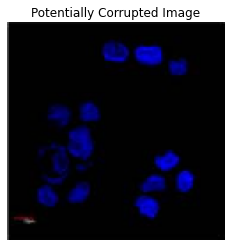

Image removed: New_folder\micro\010307.png


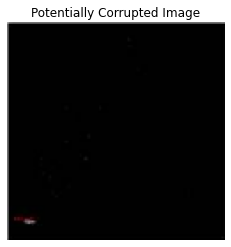

Image removed: New_folder\micro\010308.png


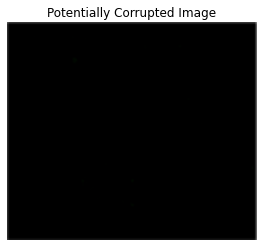

Image removed: New_folder\micro\denoised_010005.png


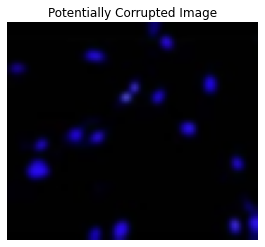

Image removed: New_folder\micro\denoised_010033.png


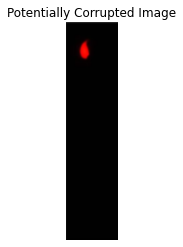

Image removed: New_folder\micro\denoised_010108.png


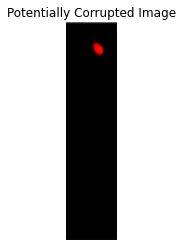

Image removed: New_folder\micro\denoised_010113.png


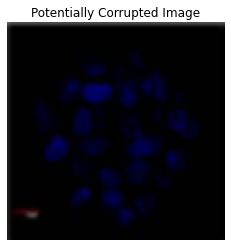

Image removed: New_folder\micro\denoised_010305.png


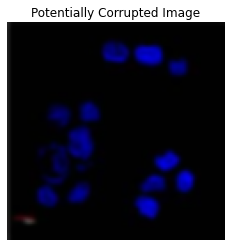

Image removed: New_folder\micro\denoised_010307.png


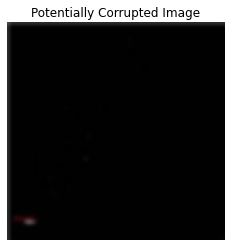

Image removed: New_folder\micro\denoised_010308.png


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# Define the base directory where images are located
base_directory = "New_folder"

# Define the threshold factor for considering images as potentially corrupted
threshold_factor = 4  # Adjust this threshold factor as needed

# Function to compute the average black value (mean intensity) of an image
def compute_average_black_value(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return np.mean(gray_image)

# Iterate through each class folder
for class_name in os.listdir(base_directory):
    class_directory = os.path.join(base_directory, class_name)

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        # Read the image
        image_path = os.path.join(class_directory, image_name)
        image = cv2.imread(image_path)

        # Compute the average black value of the image
        average_black_value = compute_average_black_value(image)

        # Check if the image is potentially corrupted
        if average_black_value < threshold_factor:
            # Display the potentially corrupted image using Matplotlib
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.title("Potentially Corrupted Image")
            plt.axis('off')
            plt.show()

            # Prompt user for action

            os.remove(image_path)
            print("Image removed:", image_path)


In [ ]:
# tryying new methodolgy

C:\Users\Shiva\AppData\Local\Temp\ipykernel_19384\2590243326.py:23: RuntimeWarning: divide by zero encountered in log
  log_transformed = c * np.log(1 + unsharp_mask)


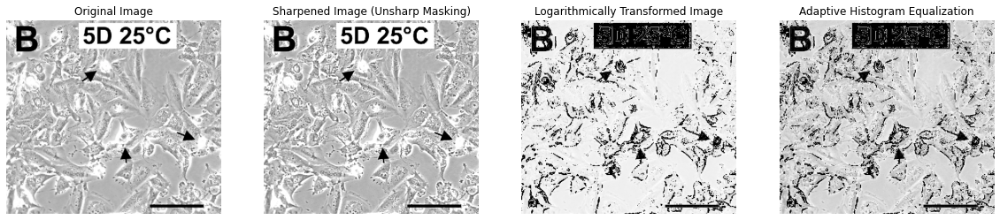

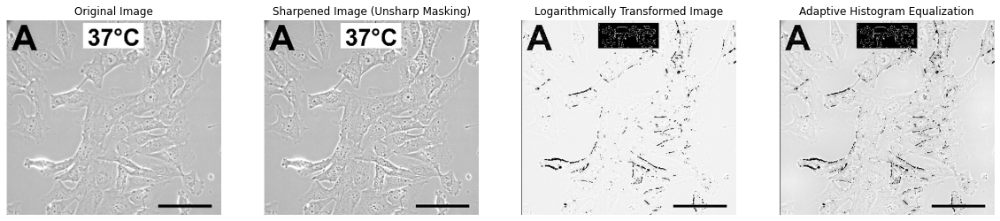

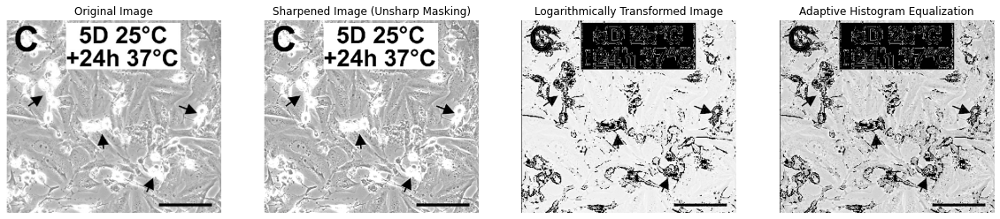

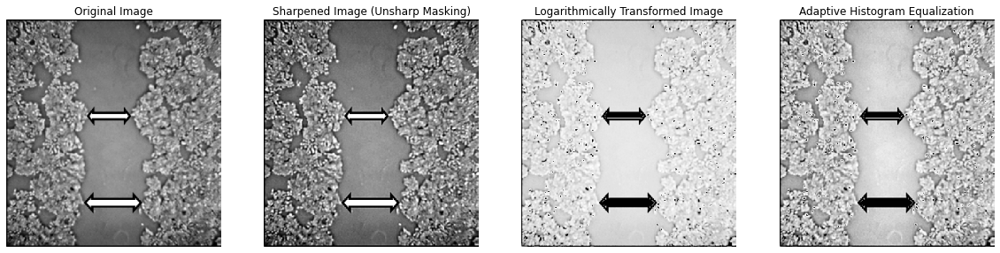

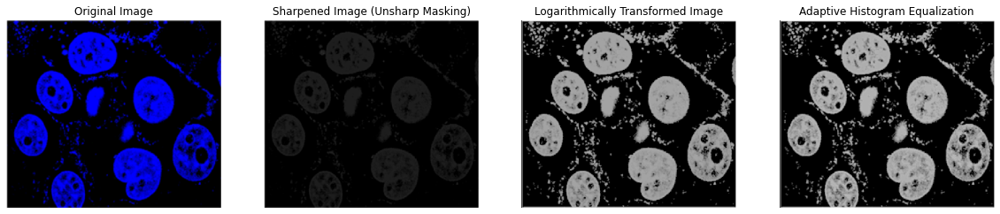

Unsharp masking, logarithmic transformation, and adaptive histogram equalization complete.


In [ ]:


    # Initialize a counter for the number of images displayed
    display_count = 0

    # Iterate through each image in the class folder
    for image_name in os.listdir(class_directory):
        if display_count >= images_per_class:
            break

        image_path = os.path.join(class_directory, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply Unsharp masking for sharpening
        gaussian_blur = cv2.GaussianBlur(gray_image, (5, 5), 10)
        unsharp_mask = cv2.addWeighted(gray_image, 1.5, gaussian_blur, -0.5, 0)

        # Apply logarithmic transformation
        c = 255 / np.log(1 + np.max(unsharp_mask))
        log_transformed = c * np.log(1 + unsharp_mask)
        log_transformed = np.uint8(log_transformed)

        # Apply adaptive histogram equalization
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        clahe_output = clahe.apply(log_transformed)

        # Plot the original, sharpened, logarithmically transformed, and histogram equalized images
        fig, axes = plt.subplots(1, 4, figsize=(20, 5))
        axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(unsharp_mask, cmap='gray')
        axes[1].set_title('Sharpened Image (Unsharp Masking)')
        axes[1].axis('off')
        axes[2].imshow(log_transformed, cmap='gray')
        axes[2].set_title('Logarithmically Transformed Image')
        axes[2].axis('off')
        axes[3].imshow(clahe_output, cmap='gray')
        axes[3].set_title('Adaptive Histogram Equalization')
        axes[3].axis('off')
        plt.show()

        # Increment the display count
        display_count += 1

print("Unsharp masking, logarithmic transformation, and adaptive histogram equalization complete.")


Displaying images from class: Blot_!


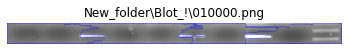

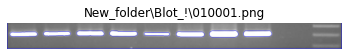

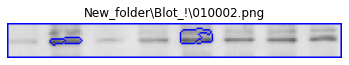

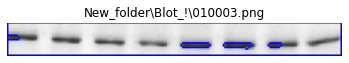

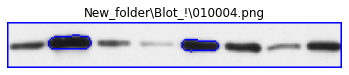

Displaying images from class: fac_1


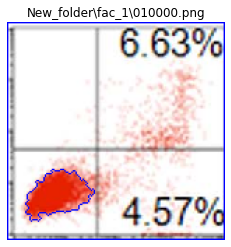

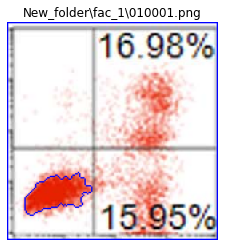

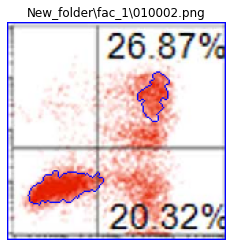

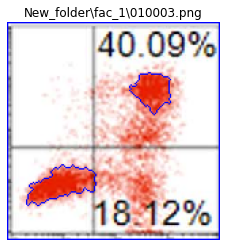

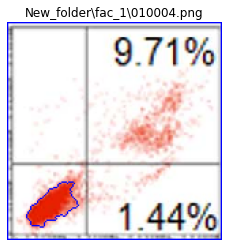

Displaying images from class: macro


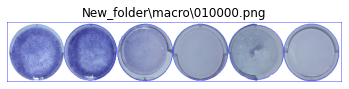

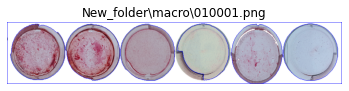

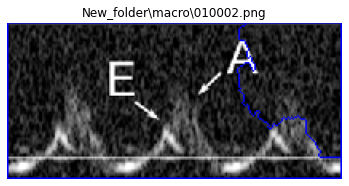

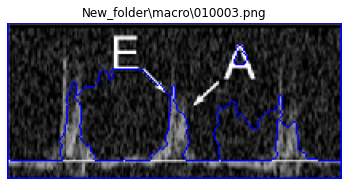

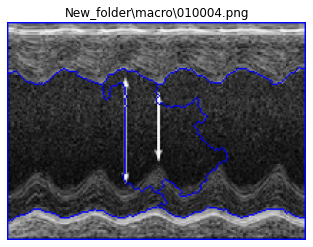

Displaying images from class: micro


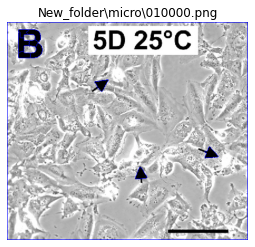

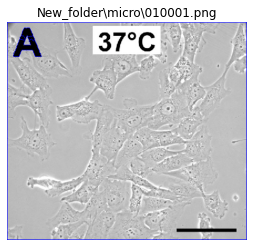

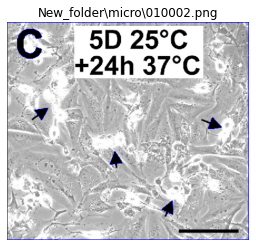

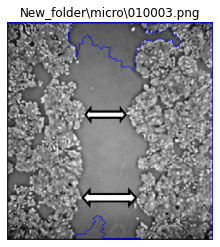

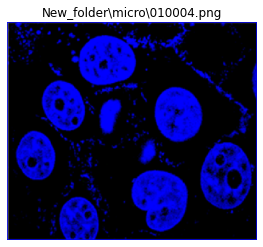

In [ ]:


def watershed_thresholding(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply thresholding
    ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

    # Noise removal
    kernel = np.ones((3,3), np.uint8)
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

    # Sure background area
    sure_bg = cv2.dilate(opening, kernel, iterations=3)

    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.7*dist_transform.max(), 255, 0)

    # Finding unknown region
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Marker labelling
    ret, markers = cv2.connectedComponents(sure_fg)

    # Add one to all labels so that sure background is not 0, but 1
    markers = markers + 1

    # Now, mark the region of unknown with zero
    markers[unknown==255] = 0

    # Apply watershed algorithm
    markers = cv2.watershed(image, markers)
    image[markers == -1] = [255, 0, 0]  # Mark watershed boundaries

    return image

def display_images_from_each_class(folder_path, num_images_per_class=5):
    classes = os.listdir(folder_path)
    for class_name in classes:
        class_path = os.path.join(folder_path, class_name)
        if os.path.isdir(class_path):
            print(f"Displaying images from class: {class_name}")
            images = os.listdir(class_path)
            images_to_display = min(len(images), num_images_per_class)
            for i in range(images_to_display):
                image_path = os.path.join(class_path, images[i])
                # Read the image
                image = cv2.imread(image_path)

                # Apply watershed thresholding
                result = watershed_thresholding(image)

                # Convert image from BGR to RGB for matplotlib
                result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)

                # Display the result using matplotlib
                plt.imshow(result_rgb)
                plt.axis('off')
                plt.title(image_path)
                plt.show()

# Specify the main folder containing subfolders with images
main_folder = 'New_folder'

# Display 5 images from each class in the main folder
display_images_from_each_class(main_folder, num_images_per_class=5)
